In [187]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")

# Customer Churn Analysis
## Problem Statement:
#### Customer churn is when a company’s customers stop doing business with that company. Businesses are very keen on measuring churn because keeping an existing customer is far less expensive than acquiring a new customer. New business involves working leads through a sales funnel, using marketing and sales budgets to gain additional customers. Existing customers will often have a higher volume of service consumption and can generate additional customer referrals.

#### Customer retention can be achieved with good customer service and products. But the most effective way for a company to prevent attrition of customers is to truly know them. The vast volumes of data collected about customers can be used to build churn prediction models. Knowing who is most likely to defect means that a company can prioritise focused marketing efforts on that subset of their customer base.

#### Preventing customer churn is critically important to the telecommunications sector, as the barriers to entry for switching services are so low. 

#### You will examine customer data from IBM Sample Data Sets with the aim of building and comparing several customer churn prediction models. 

In [188]:
data =  pd.read_csv("customer_churn_analysis.csv")

data

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes
5,9305-CDSKC,Female,0,No,No,8,Yes,Yes,Fiber optic,No,No,Yes,No,Yes,Yes,Month-to-month,Yes,Electronic check,99.65,820.5,Yes
6,1452-KIOVK,Male,0,No,Yes,22,Yes,Yes,Fiber optic,No,Yes,No,No,Yes,No,Month-to-month,Yes,Credit card (automatic),89.10,1949.4,No
7,6713-OKOMC,Female,0,No,No,10,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,No,Mailed check,29.75,301.9,No
8,7892-POOKP,Female,0,Yes,No,28,Yes,Yes,Fiber optic,No,No,Yes,Yes,Yes,Yes,Month-to-month,Yes,Electronic check,104.80,3046.05,Yes
9,6388-TABGU,Male,0,No,Yes,62,Yes,No,DSL,Yes,Yes,No,No,No,No,One year,No,Bank transfer (automatic),56.15,3487.95,No


# Checking the columns 

In [189]:
data.columns

Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'tenure', 'PhoneService', 'MultipleLines', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport',
       'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling',
       'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn'],
      dtype='object')

# Checking shape of the data 

In [190]:
data.shape

(7043, 21)

#### We have the data with 7043 rows and 21 columns

In [191]:
data.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


# Sample data

In [192]:
data.sample(17)

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
485,7971-HLVXI,Male,0,Yes,Yes,72,Yes,Yes,Fiber optic,No,No,No,No,No,Yes,Two year,Yes,Credit card (automatic),84.50,6130.85,No
2006,0224-HJAPT,Male,0,No,No,5,Yes,Yes,DSL,No,No,No,No,No,No,Month-to-month,No,Electronic check,47.15,223.15,Yes
3707,9537-JALFH,Male,0,Yes,Yes,69,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Bank transfer (automatic),19.90,1356.7,No
2790,5013-SBUIH,Female,0,No,No,50,Yes,Yes,Fiber optic,Yes,Yes,No,Yes,Yes,Yes,Two year,Yes,Electronic check,109.65,5551.15,Yes
1039,9948-YPTDG,Male,0,Yes,No,38,Yes,No,Fiber optic,Yes,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,79.45,3013.05,Yes
4573,6855-VLGOS,Male,0,Yes,Yes,72,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Electronic check,20.55,1432.55,No
1199,7126-RBHSD,Female,0,Yes,No,17,Yes,Yes,Fiber optic,Yes,No,No,No,No,No,Month-to-month,No,Electronic check,78.90,1348.95,No
4141,8450-UYIBU,Female,1,No,No,35,No,No phone service,DSL,No,No,Yes,No,Yes,No,Month-to-month,Yes,Electronic check,39.85,1434.6,No
5625,8963-MQVYN,Female,0,No,Yes,22,Yes,No,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Month-to-month,Yes,Electronic check,20.55,469.85,No
640,9574-BOSMD,Male,0,Yes,Yes,68,Yes,Yes,No,No internet service,No internet service,No internet service,No internet service,No internet service,No internet service,Two year,No,Bank transfer (automatic),25.40,1620.2,No


# Checking data types

In [193]:
data.dtypes

customerID           object
gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges         object
Churn                object
dtype: object

# Describing data

In [194]:
data.describe()

,SeniorCitizen,tenure,MonthlyCharges
count,7043.000000,7043.000000,7043.000000
mean,0.162147,32.371149,64.761692
std,0.368612,24.559481,30.090047
min,0.000000,0.000000,18.250000
25%,0.000000,9.000000,35.500000
50%,0.000000,29.000000,70.350000
75%,0.000000,55.000000,89.850000
max,1.000000,72.000000,118.750000


# Checking for null data

In [195]:
data.isnull().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

<AxesSubplot:>

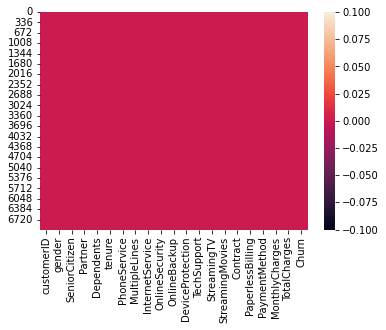

In [196]:
sns.heatmap (data.isnull())

# We can see there is no null data

# Checking for unique values

In [197]:
data.nunique()

customerID          7043
gender                 2
SeniorCitizen          2
Partner                2
Dependents             2
tenure                73
PhoneService           2
MultipleLines          3
InternetService        3
OnlineSecurity         3
OnlineBackup           3
DeviceProtection       3
TechSupport            3
StreamingTV            3
StreamingMovies        3
Contract               3
PaperlessBilling       2
PaymentMethod          4
MonthlyCharges      1585
TotalCharges        6531
Churn                  2
dtype: int64

In [198]:
data.columns

Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'tenure', 'PhoneService', 'MultipleLines', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport',
       'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling',
       'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn'],
      dtype='object')

# Checking unique values in each column

In [199]:
data["customerID"].value_counts()

7590-VHVEG    1
3791-LGQCY    1
6008-NAIXK    1
5956-YHHRX    1
5365-LLFYV    1
5855-EIBDE    1
8166-ZZTFS    1
0129-KPTWJ    1
9128-CPXKI    1
9509-MPYOD    1
0594-UFTUL    1
0463-TXOAK    1
0265-PSUAE    1
7036-ZZKBD    1
1928-BXYIV    1
2832-SCUCO    1
2988-GBIVW    1
3647-GMGDH    1
8024-XNAFQ    1
0345-XMMUG    1
6305-YLBMM    1
9360-OMDZZ    1
0504-HHAPI    1
9965-YOKZB    1
1986-PHGZF    1
8218-FFJDS    1
2956-GGUCQ    1
5760-FXFVO    1
3049-SOLAY    1
0362-ZBZWJ    1
7813-ZGGAW    1
6522-OIQSX    1
6119-SPUDB    1
3154-HMWUU    1
2192-CKRLV    1
1541-ETJZO    1
5073-RZGBK    1
4274-OWWYO    1
7581-EBBOU    1
4211-MMAZN    1
8979-CAMGB    1
3556-BVQGL    1
6595-COKXZ    1
9356-AXGMP    1
5176-OLSKT    1
7508-DQAKK    1
0016-QLJIS    1
7544-ZVIKX    1
7550-WIQVA    1
5871-DGTXZ    1
7816-VGHTO    1
4007-NHVHI    1
5181-OABFK    1
0961-ZWLVI    1
3006-XIMLN    1
8443-WVPSS    1
3011-WQKSZ    1
1269-FOYWN    1
7396-VJUZB    1
5032-MIYKT    1
5219-YIPTK    1
5701-ZIKJE    1
1230-QAJ

In [200]:
data["gender"].value_counts()

Male      3555
Female    3488
Name: gender, dtype: int64

In [201]:
data["SeniorCitizen"].value_counts()

0    5901
1    1142
Name: SeniorCitizen, dtype: int64

In [202]:
data["Partner"].value_counts()

No     3641
Yes    3402
Name: Partner, dtype: int64

In [203]:
data["Dependents"].value_counts()

No     4933
Yes    2110
Name: Dependents, dtype: int64

In [204]:
data["tenure"].value_counts()

1     613
72    362
2     238
3     200
4     176
71    170
5     133
7     131
8     123
70    119
9     119
12    117
10    116
6     110
13    109
68    100
11     99
15     99
67     98
18     97
69     95
24     94
22     90
66     89
35     88
17     87
23     85
16     80
64     80
56     80
52     80
26     79
25     79
61     76
14     76
65     76
60     76
46     74
19     73
29     72
27     72
30     72
63     72
20     71
53     70
62     70
41     70
32     69
50     68
47     68
51     68
54     68
58     67
49     66
57     65
31     65
43     65
37     65
42     65
34     65
33     64
55     64
48     64
40     64
21     63
45     61
59     60
38     59
28     57
39     56
44     51
36     50
0      11
Name: tenure, dtype: int64

In [205]:
data["PhoneService"].value_counts()

Yes    6361
No      682
Name: PhoneService, dtype: int64

In [206]:
data["MultipleLines"].value_counts()

No                  3390
Yes                 2971
No phone service     682
Name: MultipleLines, dtype: int64

In [207]:
data["InternetService"].value_counts()

Fiber optic    3096
DSL            2421
No             1526
Name: InternetService, dtype: int64

In [208]:
data["OnlineSecurity"].value_counts()

No                     3498
Yes                    2019
No internet service    1526
Name: OnlineSecurity, dtype: int64

In [209]:
data["OnlineBackup"].value_counts()

No                     3088
Yes                    2429
No internet service    1526
Name: OnlineBackup, dtype: int64

In [210]:
data["DeviceProtection"].value_counts()

No                     3095
Yes                    2422
No internet service    1526
Name: DeviceProtection, dtype: int64

In [211]:
data["TechSupport"].value_counts()

No                     3473
Yes                    2044
No internet service    1526
Name: TechSupport, dtype: int64

In [212]:
data["StreamingTV"].value_counts()

No                     2810
Yes                    2707
No internet service    1526
Name: StreamingTV, dtype: int64

In [213]:
data["StreamingMovies"].value_counts()

No                     2785
Yes                    2732
No internet service    1526
Name: StreamingMovies, dtype: int64

In [214]:
data["Contract"].value_counts()

Month-to-month    3875
Two year          1695
One year          1473
Name: Contract, dtype: int64

In [215]:
data["PaperlessBilling"].value_counts()

Yes    4171
No     2872
Name: PaperlessBilling, dtype: int64

In [216]:
data["PaymentMethod"].value_counts()

Electronic check             2365
Mailed check                 1612
Bank transfer (automatic)    1544
Credit card (automatic)      1522
Name: PaymentMethod, dtype: int64

In [217]:
data["MonthlyCharges"].value_counts()

20.05     61
19.85     45
19.95     44
19.90     44
20.00     43
19.70     43
19.65     43
19.55     40
20.15     40
19.75     39
20.25     39
20.35     38
19.80     38
20.10     37
19.60     37
20.20     35
19.50     32
20.45     31
19.40     31
20.40     30
19.45     28
20.50     28
20.30     28
20.55     27
19.35     25
19.30     24
20.65     23
25.25     20
25.10     19
19.25     18
25.00     17
19.20     17
84.80     17
20.75     17
74.40     16
81.00     15
24.80     15
24.45     15
20.60     15
20.85     15
79.20     14
70.15     14
25.05     14
25.15     14
79.85     14
80.45     14
89.85     13
75.35     13
95.00     13
69.95     13
20.70     13
89.55     13
80.85     13
24.70     12
70.30     12
75.50     12
94.40     12
25.40     12
24.95     12
19.10     12
74.90     12
55.00     12
80.55     12
84.30     12
85.45     12
85.30     12
80.60     11
74.35     11
60.00     11
75.10     11
74.30     11
24.40     11
90.05     11
19.15     11
80.00     11
99.00     11
55.30     11

In [218]:
data["TotalCharges"].value_counts()

           11
20.2       11
19.75       9
20.05       8
19.9        8
19.65       8
45.3        7
19.55       7
20.15       6
20.25       6
19.45       6
20.3        5
20.45       5
19.85       4
69.9        4
20.4        4
70.6        4
19.2        4
69.65       4
44          4
44.4        4
20.5        4
49.9        4
74.7        4
19.3        4
19.95       4
19.5        4
75.3        4
50.15       4
20.35       4
69.6        4
19.4        4
69.95       4
19.25       3
70.45       3
1284.2      3
69.25       3
74.3        3
20.9        3
220.45      3
20.55       3
69.1        3
20.1        3
305.55      3
50.6        3
74.6        3
20          3
45.85       3
44.75       3
70.15       3
75.35       3
19.1        3
74.9        3
86.05       3
79.55       3
74.35       3
35.9        3
24.4        3
45.7        3
2317.1      3
383.65      3
50.75       3
25.25       3
55.7        3
45.1        3
84.5        3
85          3
50.45       3
80.55       3
70.3        3
24.8        3
470.2 

In [219]:
data["Churn"].value_counts()

No     5174
Yes    1869
Name: Churn, dtype: int64

In [220]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        7043 non-null   object 
 1   gender            7043 non-null   object 
 2   SeniorCitizen     7043 non-null   int64  
 3   Partner           7043 non-null   object 
 4   Dependents        7043 non-null   object 
 5   tenure            7043 non-null   int64  
 6   PhoneService      7043 non-null   object 
 7   MultipleLines     7043 non-null   object 
 8   InternetService   7043 non-null   object 
 9   OnlineSecurity    7043 non-null   object 
 10  OnlineBackup      7043 non-null   object 
 11  DeviceProtection  7043 non-null   object 
 12  TechSupport       7043 non-null   object 
 13  StreamingTV       7043 non-null   object 
 14  StreamingMovies   7043 non-null   object 
 15  Contract          7043 non-null   object 
 16  PaperlessBilling  7043 non-null   object 


# Univariate analysis

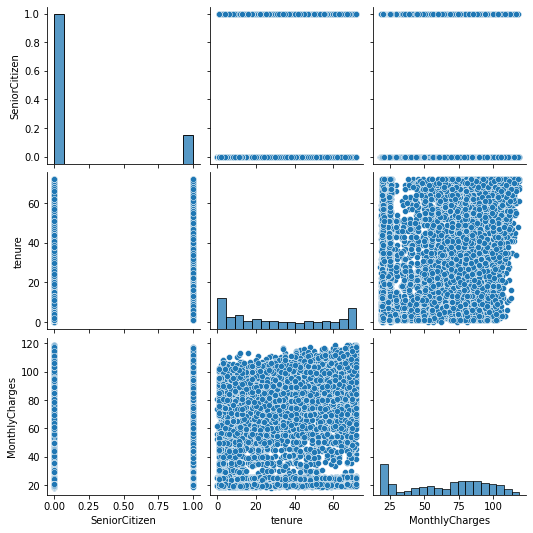

In [221]:
sns.pairplot(data)

In [222]:
data.columns

Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'tenure', 'PhoneService', 'MultipleLines', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport',
       'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling',
       'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn'],
      dtype='object')

7590-VHVEG    1
3791-LGQCY    1
6008-NAIXK    1
5956-YHHRX    1
5365-LLFYV    1
5855-EIBDE    1
8166-ZZTFS    1
0129-KPTWJ    1
9128-CPXKI    1
9509-MPYOD    1
0594-UFTUL    1
0463-TXOAK    1
0265-PSUAE    1
7036-ZZKBD    1
1928-BXYIV    1
2832-SCUCO    1
2988-GBIVW    1
3647-GMGDH    1
8024-XNAFQ    1
0345-XMMUG    1
6305-YLBMM    1
9360-OMDZZ    1
0504-HHAPI    1
9965-YOKZB    1
1986-PHGZF    1
8218-FFJDS    1
2956-GGUCQ    1
5760-FXFVO    1
3049-SOLAY    1
0362-ZBZWJ    1
7813-ZGGAW    1
6522-OIQSX    1
6119-SPUDB    1
3154-HMWUU    1
2192-CKRLV    1
1541-ETJZO    1
5073-RZGBK    1
4274-OWWYO    1
7581-EBBOU    1
4211-MMAZN    1
8979-CAMGB    1
3556-BVQGL    1
6595-COKXZ    1
9356-AXGMP    1
5176-OLSKT    1
7508-DQAKK    1
0016-QLJIS    1
7544-ZVIKX    1
7550-WIQVA    1
5871-DGTXZ    1
7816-VGHTO    1
4007-NHVHI    1
5181-OABFK    1
0961-ZWLVI    1
3006-XIMLN    1
8443-WVPSS    1
3011-WQKSZ    1
1269-FOYWN    1
7396-VJUZB    1
5032-MIYKT    1
5219-YIPTK    1
5701-ZIKJE    1
1230-QAJ

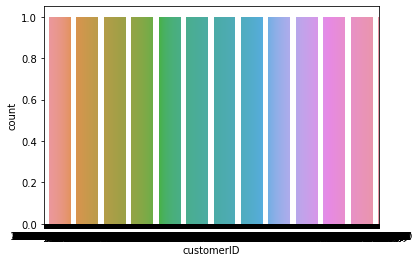

In [223]:
sns.countplot(data["customerID"]  , data = data)
data["customerID"].value_counts()

Male      3555
Female    3488
Name: gender, dtype: int64

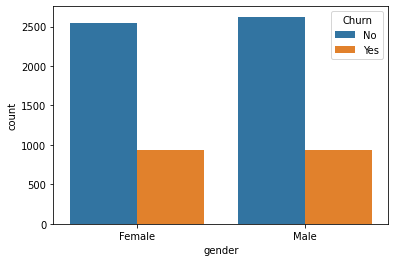

In [224]:
sns.countplot(data["gender"]  , data = data , hue = "Churn")
data["gender"].value_counts()

0    5901
1    1142
Name: SeniorCitizen, dtype: int64

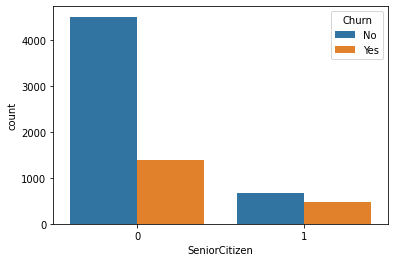

In [225]:
sns.countplot(data["SeniorCitizen"]  , data = data ,hue = "Churn")
data["SeniorCitizen"].value_counts()

No     3641
Yes    3402
Name: Partner, dtype: int64

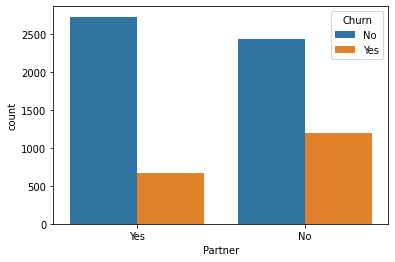

In [226]:
sns.countplot(data["Partner"]  , data = data , hue = "Churn")
data["Partner"].value_counts()

No     4933
Yes    2110
Name: Dependents, dtype: int64

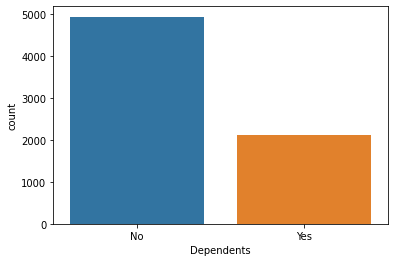

In [227]:
sns.countplot(data["Dependents"]  , data = data)
data["Dependents"].value_counts()

1     613
72    362
2     238
3     200
4     176
71    170
5     133
7     131
8     123
70    119
9     119
12    117
10    116
6     110
13    109
68    100
11     99
15     99
67     98
18     97
69     95
24     94
22     90
66     89
35     88
17     87
23     85
16     80
64     80
56     80
52     80
26     79
25     79
61     76
14     76
65     76
60     76
46     74
19     73
29     72
27     72
30     72
63     72
20     71
53     70
62     70
41     70
32     69
50     68
47     68
51     68
54     68
58     67
49     66
57     65
31     65
43     65
37     65
42     65
34     65
33     64
55     64
48     64
40     64
21     63
45     61
59     60
38     59
28     57
39     56
44     51
36     50
0      11
Name: tenure, dtype: int64

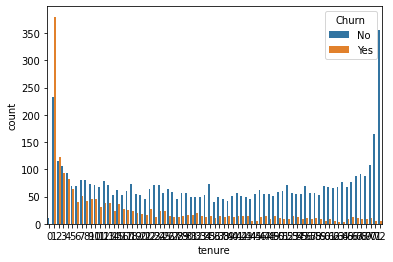

In [228]:
sns.countplot(data["tenure"]  , data = data , hue = "Churn")
data["tenure"].value_counts()

Yes    6361
No      682
Name: PhoneService, dtype: int64

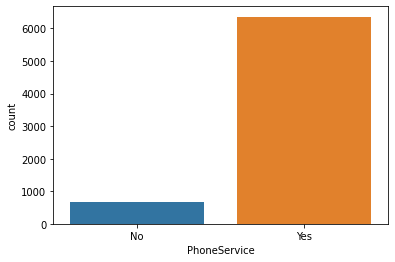

In [229]:
sns.countplot(data["PhoneService"]  , data = data)
data["PhoneService"].value_counts()

No                  3390
Yes                 2971
No phone service     682
Name: MultipleLines, dtype: int64

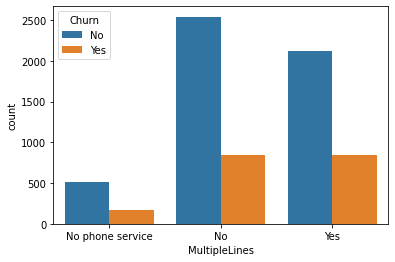

In [230]:
sns.countplot(data["MultipleLines"]  , data = data , hue = "Churn")
data["MultipleLines"].value_counts()

Fiber optic    3096
DSL            2421
No             1526
Name: InternetService, dtype: int64

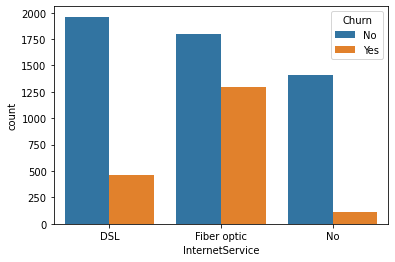

In [231]:
sns.countplot(data["InternetService"]  , data = data , hue = "Churn")
data["InternetService"].value_counts()

No                     3498
Yes                    2019
No internet service    1526
Name: OnlineSecurity, dtype: int64

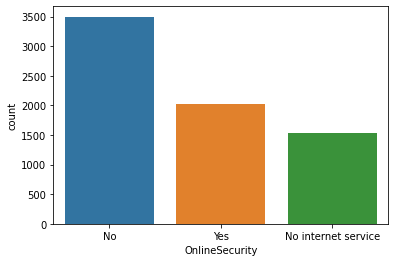

In [232]:
sns.countplot(data["OnlineSecurity"]  , data = data)
data["OnlineSecurity"].value_counts()

No                     3088
Yes                    2429
No internet service    1526
Name: OnlineBackup, dtype: int64

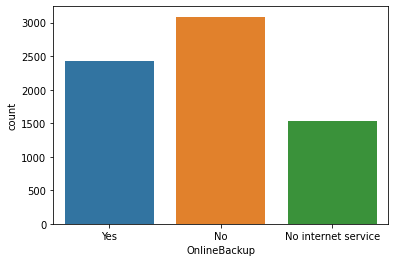

In [233]:
sns.countplot(data["OnlineBackup"]  , data = data)
data["OnlineBackup"].value_counts()

No                     3095
Yes                    2422
No internet service    1526
Name: DeviceProtection, dtype: int64

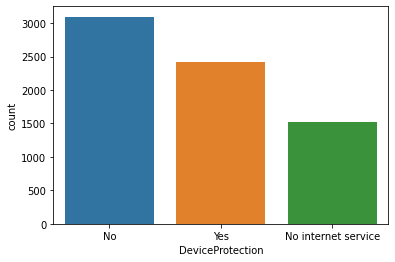

In [234]:
sns.countplot(data["DeviceProtection"]  , data = data)
data["DeviceProtection"].value_counts()

No                     3473
Yes                    2044
No internet service    1526
Name: TechSupport, dtype: int64

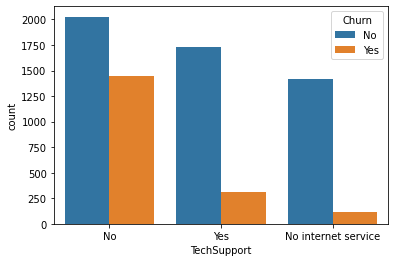

In [235]:
sns.countplot(data["TechSupport"]  , data = data , hue = "Churn")
data["TechSupport"].value_counts()

No                     2810
Yes                    2707
No internet service    1526
Name: StreamingTV, dtype: int64

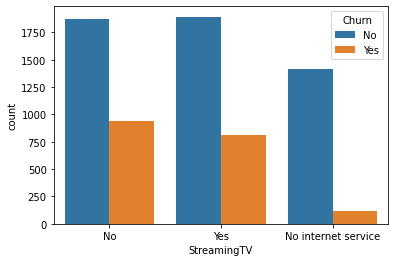

In [236]:
sns.countplot(data["StreamingTV"]  , data = data , hue = "Churn")
data["StreamingTV"].value_counts()

No                     2785
Yes                    2732
No internet service    1526
Name: StreamingMovies, dtype: int64

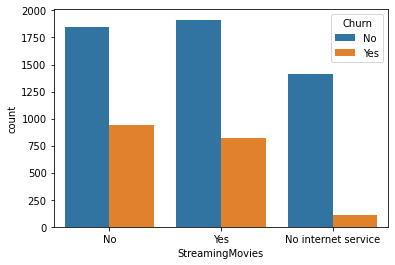

In [237]:
sns.countplot(data["StreamingMovies"]  , data = data , hue = "Churn")
data["StreamingMovies"].value_counts()

Month-to-month    3875
Two year          1695
One year          1473
Name: Contract, dtype: int64

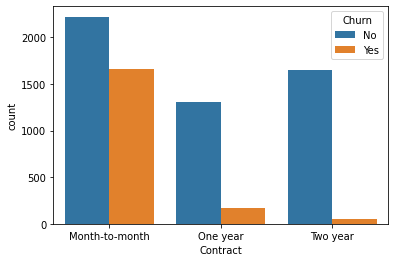

In [238]:
sns.countplot(data["Contract"]  , data = data , hue  = "Churn")
data["Contract"].value_counts()

Yes    4171
No     2872
Name: PaperlessBilling, dtype: int64

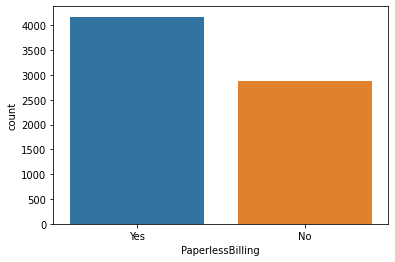

In [239]:
sns.countplot(data["PaperlessBilling"]  , data = data)
data["PaperlessBilling"].value_counts()

Electronic check             2365
Mailed check                 1612
Bank transfer (automatic)    1544
Credit card (automatic)      1522
Name: PaymentMethod, dtype: int64

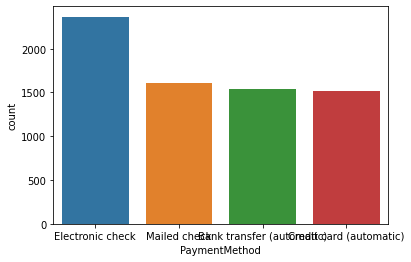

In [240]:
sns.countplot(data["PaymentMethod"]  , data = data )
data["PaymentMethod"].value_counts()

20.05     61
19.85     45
19.95     44
19.90     44
20.00     43
19.70     43
19.65     43
19.55     40
20.15     40
19.75     39
20.25     39
20.35     38
19.80     38
20.10     37
19.60     37
20.20     35
19.50     32
20.45     31
19.40     31
20.40     30
19.45     28
20.50     28
20.30     28
20.55     27
19.35     25
19.30     24
20.65     23
25.25     20
25.10     19
19.25     18
25.00     17
19.20     17
84.80     17
20.75     17
74.40     16
81.00     15
24.80     15
24.45     15
20.60     15
20.85     15
79.20     14
70.15     14
25.05     14
25.15     14
79.85     14
80.45     14
89.85     13
75.35     13
95.00     13
69.95     13
20.70     13
89.55     13
80.85     13
24.70     12
70.30     12
75.50     12
94.40     12
25.40     12
24.95     12
19.10     12
74.90     12
55.00     12
80.55     12
84.30     12
85.45     12
85.30     12
80.60     11
74.35     11
60.00     11
75.10     11
74.30     11
24.40     11
90.05     11
19.15     11
80.00     11
99.00     11
55.30     11

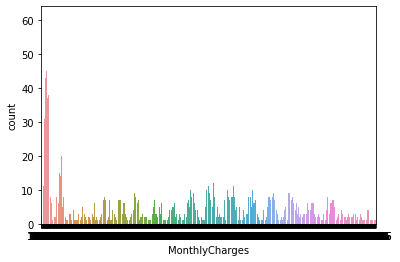

In [241]:
sns.countplot(data["MonthlyCharges"]  , data = data)
data["MonthlyCharges"].value_counts()

           11
20.2       11
19.75       9
20.05       8
19.9        8
19.65       8
45.3        7
19.55       7
20.15       6
20.25       6
19.45       6
20.3        5
20.45       5
19.85       4
69.9        4
20.4        4
70.6        4
19.2        4
69.65       4
44          4
44.4        4
20.5        4
49.9        4
74.7        4
19.3        4
19.95       4
19.5        4
75.3        4
50.15       4
20.35       4
69.6        4
19.4        4
69.95       4
19.25       3
70.45       3
1284.2      3
69.25       3
74.3        3
20.9        3
220.45      3
20.55       3
69.1        3
20.1        3
305.55      3
50.6        3
74.6        3
20          3
45.85       3
44.75       3
70.15       3
75.35       3
19.1        3
74.9        3
86.05       3
79.55       3
74.35       3
35.9        3
24.4        3
45.7        3
2317.1      3
383.65      3
50.75       3
25.25       3
55.7        3
45.1        3
84.5        3
85          3
50.45       3
80.55       3
70.3        3
24.8        3
470.2 

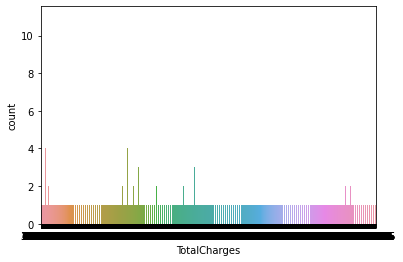

In [242]:
sns.countplot(data["TotalCharges"]  , data = data)
data["TotalCharges"].value_counts()

No     5174
Yes    1869
Name: Churn, dtype: int64

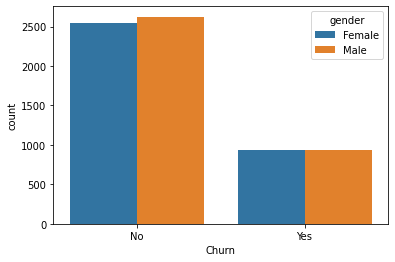

In [243]:
sns.countplot(data["Churn"]  , data = data, hue =  "gender")
data["Churn"].value_counts()

<AxesSubplot:xlabel='customerID', ylabel='Count'>

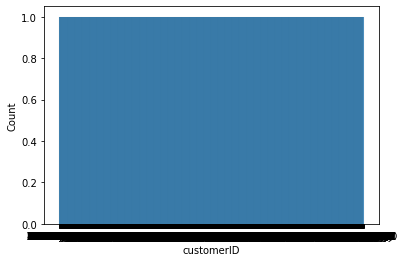

In [244]:
sns.histplot(data["customerID"])

<AxesSubplot:xlabel='gender', ylabel='Count'>

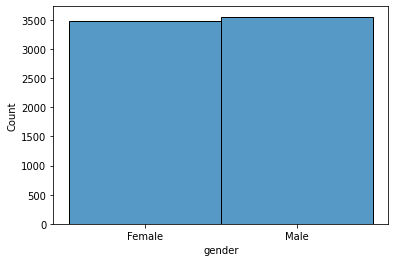

In [245]:
sns.histplot(data["gender"] )

<AxesSubplot:xlabel='Partner', ylabel='Count'>

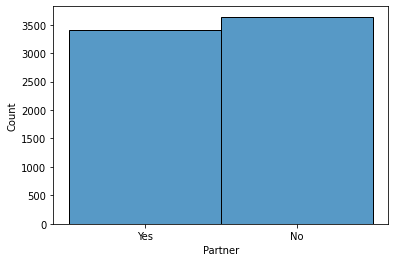

In [246]:
sns.histplot(data["Partner"])

<AxesSubplot:xlabel='Dependents', ylabel='Count'>

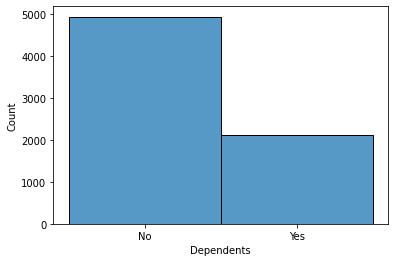

In [247]:
sns.histplot(data["Dependents"])

<AxesSubplot:xlabel='tenure', ylabel='Count'>

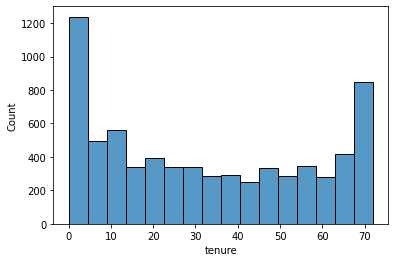

In [248]:
sns.histplot(data["tenure"])

<AxesSubplot:xlabel='PhoneService', ylabel='Count'>

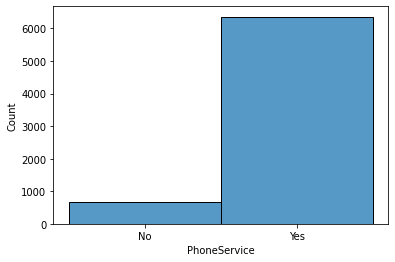

In [249]:
sns.histplot(data["PhoneService"])

<AxesSubplot:xlabel='MultipleLines', ylabel='Count'>

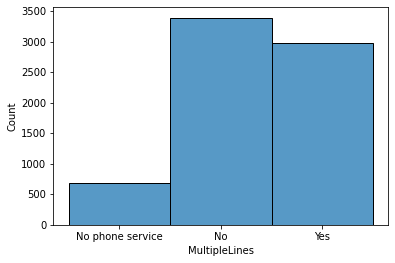

In [250]:
sns.histplot(data["MultipleLines"])

<AxesSubplot:xlabel='InternetService', ylabel='Count'>

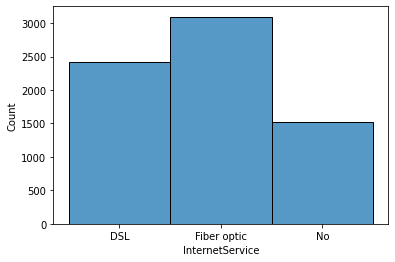

In [251]:
sns.histplot(data["InternetService"])

<AxesSubplot:xlabel='OnlineSecurity', ylabel='Count'>

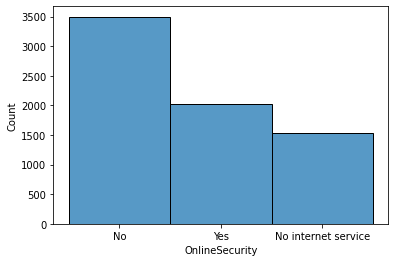

In [252]:
sns.histplot(data["OnlineSecurity"])

<AxesSubplot:xlabel='OnlineBackup', ylabel='Count'>

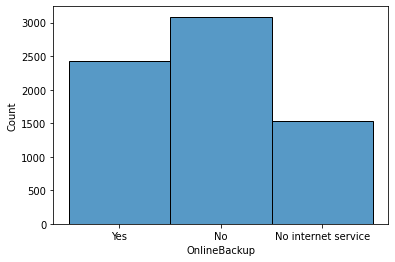

In [253]:
sns.histplot(data["OnlineBackup"])

<AxesSubplot:xlabel='DeviceProtection', ylabel='Count'>

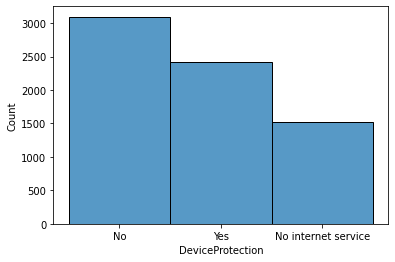

In [254]:
sns.histplot(data["DeviceProtection"])

<AxesSubplot:xlabel='TechSupport', ylabel='Count'>

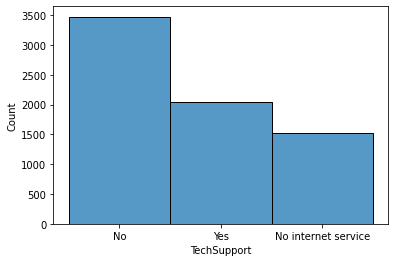

In [255]:
sns.histplot(data["TechSupport"])

<AxesSubplot:xlabel='StreamingTV', ylabel='Count'>

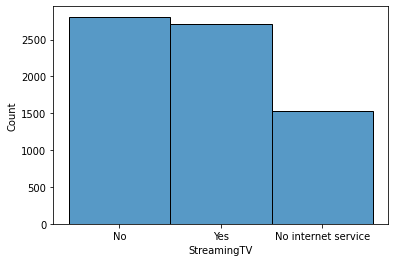

In [256]:
sns.histplot(data["StreamingTV"])

<AxesSubplot:xlabel='StreamingMovies', ylabel='Count'>

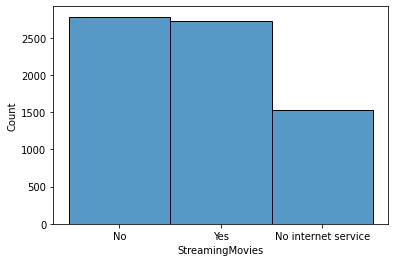

In [257]:
sns.histplot(data["StreamingMovies"])

<AxesSubplot:xlabel='Contract', ylabel='Count'>

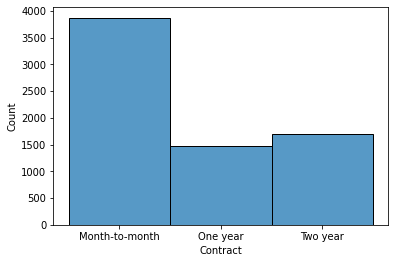

In [258]:
sns.histplot(data["Contract"])

<AxesSubplot:xlabel='PaperlessBilling', ylabel='Count'>

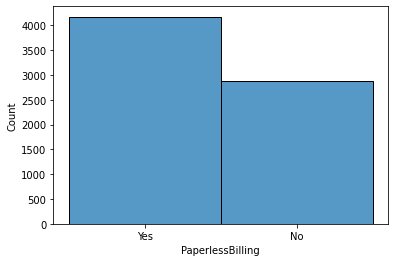

In [259]:
sns.histplot(data["PaperlessBilling"])

<AxesSubplot:xlabel='PaymentMethod', ylabel='Count'>

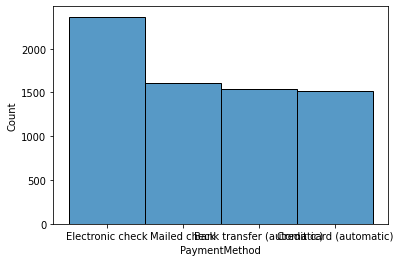

In [260]:
sns.histplot(data["PaymentMethod"])

<AxesSubplot:xlabel='MonthlyCharges', ylabel='Count'>

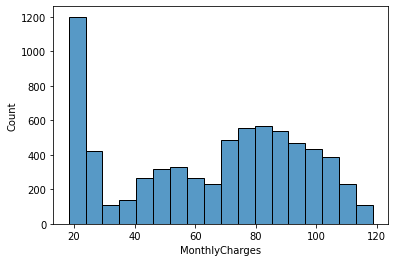

In [261]:
sns.histplot(data["MonthlyCharges"])

<AxesSubplot:xlabel='TotalCharges', ylabel='Count'>

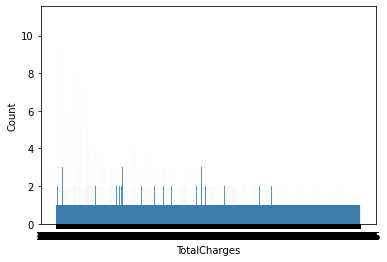

In [262]:
sns.histplot(data["TotalCharges"])

<AxesSubplot:xlabel='Churn', ylabel='Count'>

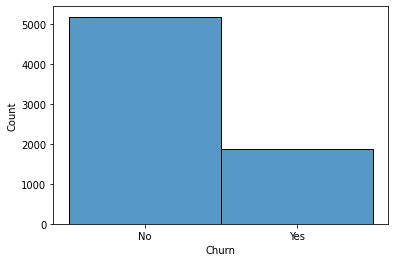

In [263]:
sns.histplot(data["Churn"])

# Bivariate Analysis

In [264]:
data.columns

Index(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'tenure', 'PhoneService', 'MultipleLines', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport',
       'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling',
       'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn'],
      dtype='object')

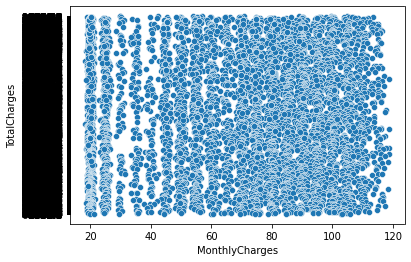

In [265]:
sns.scatterplot("MonthlyCharges","TotalCharges" , data = data)
plt.show()

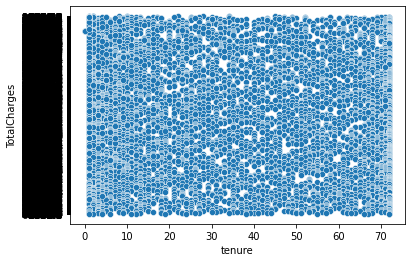

In [266]:
sns.scatterplot("tenure","TotalCharges" , data = data)
plt.show()

# feature engineering 

In [267]:
data.dtypes

customerID           object
gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges         object
Churn                object
dtype: object

we can see the  TotalCharges is object 

In [268]:
try:
    data['TotalCharges'] = data['TotalCharges'].astype(float)
except ValueError as ve:
    print (ve)

could not convert string to float: ''


In [269]:
data['TotalCharges'] = pd.to_numeric(data['TotalCharges'] , errors='coerce')
data['TotalCharges'] = data['TotalCharges'].fillna(data['TotalCharges'].median())

In [270]:
data.dtypes

customerID           object
gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges        float64
Churn                object
dtype: object

TotalCharges   is float now 


# encodin data

In [271]:
from sklearn .preprocessing import OrdinalEncoder
from sklearn .preprocessing import LabelEncoder

In [272]:
od = OrdinalEncoder ()
lb = LabelEncoder ()

In [273]:
data["Churn"] =   lb.fit_transform (data["Churn"] )

In [274]:
for i in data.columns:
    if data[i].dtypes == "object":
        data[i] = od.fit_transform(data[i].values.reshape(-1,1))

In [275]:
data.dtypes

customerID          float64
gender              float64
SeniorCitizen         int64
Partner             float64
Dependents          float64
tenure                int64
PhoneService        float64
MultipleLines       float64
InternetService     float64
OnlineSecurity      float64
OnlineBackup        float64
DeviceProtection    float64
TechSupport         float64
StreamingTV         float64
StreamingMovies     float64
Contract            float64
PaperlessBilling    float64
PaymentMethod       float64
MonthlyCharges      float64
TotalCharges        float64
Churn                 int32
dtype: object

categorical columns are now floeat

In [276]:
data

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,5375.0,0.0,0,1.0,0.0,1,0.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,29.85,29.850,0
1,3962.0,1.0,0,0.0,0.0,34,1.0,0.0,0.0,2.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,3.0,56.95,1889.500,0
2,2564.0,1.0,0,0.0,0.0,2,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,53.85,108.150,1
3,5535.0,1.0,0,0.0,0.0,45,0.0,1.0,0.0,2.0,0.0,2.0,2.0,0.0,0.0,1.0,0.0,0.0,42.30,1840.750,0
4,6511.0,0.0,0,0.0,0.0,2,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,70.70,151.650,1
5,6551.0,0.0,0,0.0,0.0,8,1.0,2.0,1.0,0.0,0.0,2.0,0.0,2.0,2.0,0.0,1.0,2.0,99.65,820.500,1
6,1002.0,1.0,0,0.0,1.0,22,1.0,2.0,1.0,0.0,2.0,0.0,0.0,2.0,0.0,0.0,1.0,1.0,89.10,1949.400,0
7,4770.0,0.0,0,0.0,0.0,10,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,29.75,301.900,0
8,5604.0,0.0,0,1.0,0.0,28,1.0,2.0,1.0,0.0,0.0,2.0,2.0,2.0,2.0,0.0,1.0,2.0,104.80,3046.050,1
9,4534.0,1.0,0,0.0,1.0,62,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,56.15,3487.950,0


# correlation 

In [277]:
data.corr()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
customerID,1.000000,0.006288,-0.002074,-0.026729,-0.012823,0.008035,-0.006483,0.004316,-0.012407,0.013292,-0.003334,-0.006918,0.001140,-0.007777,-0.016746,0.015028,-0.001945,0.011604,-0.003916,-0.000019,-0.017447
gender,0.006288,1.000000,-0.001874,-0.001808,0.010517,0.005106,-0.006488,-0.006739,-0.000863,-0.015017,-0.012057,0.000549,-0.006825,-0.006421,-0.008743,0.000126,-0.011754,0.017352,-0.014569,-0.000002,-0.008612
SeniorCitizen,-0.002074,-0.001874,1.000000,0.016479,-0.211185,0.016567,0.008576,0.146185,-0.032310,-0.128221,-0.013632,-0.021398,-0.151268,0.030776,0.047266,-0.142554,0.156530,-0.038551,0.220173,0.102652,0.150889
Partner,-0.026729,-0.001808,0.016479,1.000000,0.452676,0.379697,0.017706,0.142410,0.000891,0.150828,0.153130,0.166330,0.126733,0.137341,0.129574,0.294806,-0.014877,-0.154798,0.096848,0.318364,-0.150448
Dependents,-0.012823,0.010517,-0.211185,0.452676,1.000000,0.159712,-0.001762,-0.024991,0.044590,0.152166,0.091015,0.080537,0.133524,0.046885,0.021321,0.243187,-0.111377,-0.040292,-0.113890,0.063593,-0.164221
tenure,0.008035,0.005106,0.016567,0.379697,0.159712,1.000000,0.008448,0.343032,-0.030359,0.325468,0.370876,0.371105,0.322942,0.289373,0.296866,0.671607,0.006152,-0.370436,0.247900,0.825464,-0.352229
PhoneService,-0.006483,-0.006488,0.008576,0.017706,-0.001762,0.008448,1.000000,-0.020538,0.387436,-0.015198,0.024105,0.003727,-0.019158,0.055353,0.043870,0.002247,0.016505,-0.004184,0.247398,0.113013,0.011942
MultipleLines,0.004316,-0.006739,0.146185,0.142410,-0.024991,0.343032,-0.020538,1.000000,-0.109216,0.007141,0.117327,0.122318,0.011466,0.175059,0.180957,0.110842,0.165146,-0.176793,0.433576,0.452849,0.038037
InternetService,-0.012407,-0.000863,-0.032310,0.000891,0.044590,-0.030359,0.387436,-0.109216,1.000000,-0.028416,0.036138,0.044944,-0.026047,0.107417,0.098350,0.099721,-0.138625,0.086140,-0.323260,-0.175588,-0.047291
OnlineSecurity,0.013292,-0.015017,-0.128221,0.150828,0.152166,0.325468,-0.015198,0.007141,-0.028416,1.000000,0.185126,0.175985,0.285028,0.044669,0.055954,0.374416,-0.157641,-0.096726,-0.053878,0.253935,-0.289309


<AxesSubplot:>

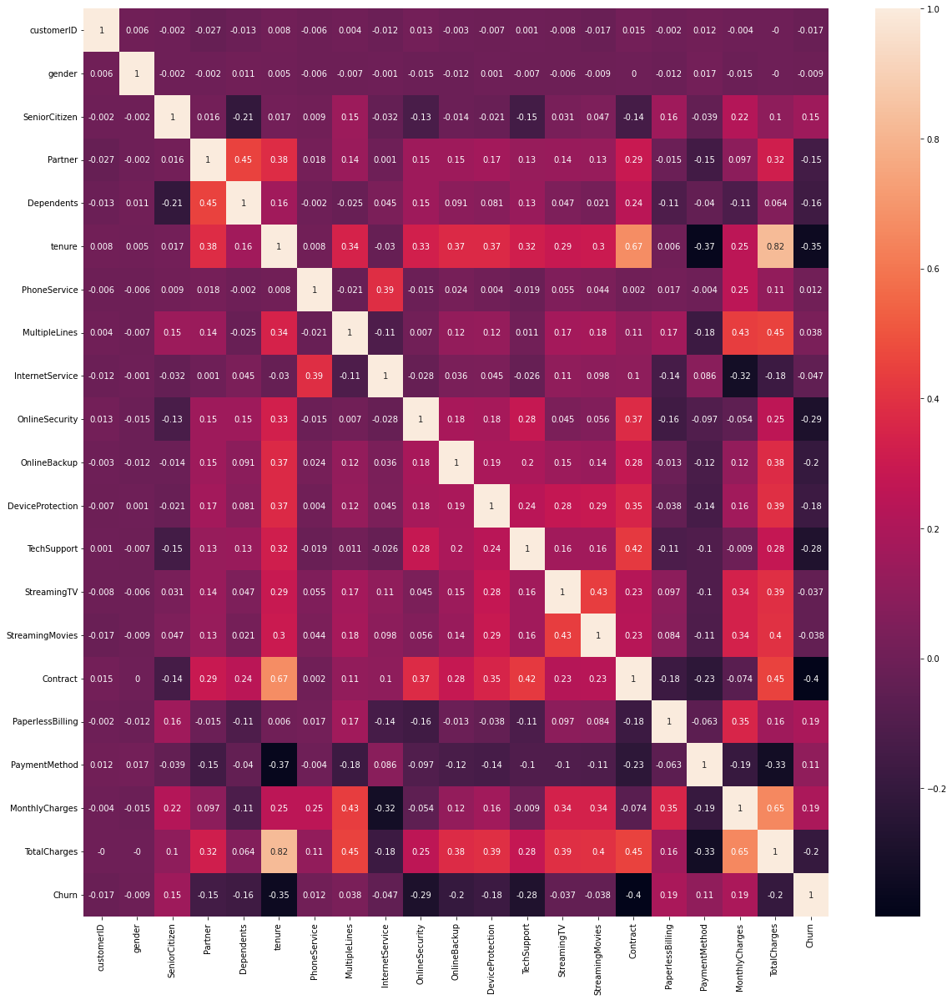

In [278]:
plt.figure(figsize = (20,20))
sns.heatmap(round(data.corr(),3) , annot = True)

#### as we can see that tenure is having high correlation with  contract and total charges 
#### dropping  tenur

In [279]:

data.drop(["tenure"] , axis = 1 , inplace = True)

# checking outlier

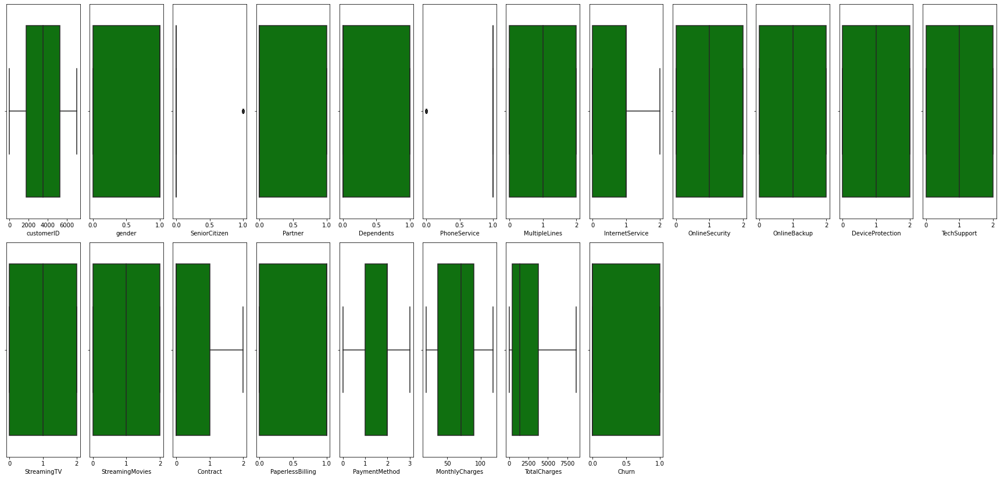

In [280]:
column = data.columns.values
ncol = 12
nrows = 158
plt.figure(figsize = (2*ncol,75*ncol))
for i in range ( 0 ,len(column)):
    plt.subplot(nrows,ncol,i+1)
    sns.boxplot(data[column[i]],color ="green",orient = "h")    
    plt.tight_layout()

In [281]:
from scipy.stats import zscore
import numpy as np
z = np.abs(zscore(data))
data.shape

(7043, 20)

In [282]:
len(np.where(z>3)[0])

682

In [283]:
data_ = data[(z<3).all(axis=1)]

In [284]:
data_.shape

(6361, 20)

### outliers are now cleared 

# checking skewness

In [285]:
data_.skew()

customerID          0.006843
gender             -0.014781
SeniorCitizen       1.823376
Partner             0.056316
Dependents          0.876594
PhoneService        0.000000
MultipleLines       0.132058
InternetService     0.049126
OnlineSecurity      0.422032
OnlineBackup        0.167910
DeviceProtection    0.183254
TechSupport         0.409833
StreamingTV        -0.002734
StreamingMovies    -0.010025
Contract            0.629701
PaperlessBilling   -0.386613
PaymentMethod      -0.169889
MonthlyCharges     -0.399139
TotalCharges        0.900834
Churn               1.053055
dtype: float64

In [286]:
from sklearn.preprocessing import  power_transform
data_["TotalCharges"] =  power_transform(data_["TotalCharges"].array.reshape(-1, 1),method = 'yeo-johnson')

In [287]:
data_.skew()

customerID          0.006843
gender             -0.014781
SeniorCitizen       1.823376
Partner             0.056316
Dependents          0.876594
PhoneService        0.000000
MultipleLines       0.132058
InternetService     0.049126
OnlineSecurity      0.422032
OnlineBackup        0.167910
DeviceProtection    0.183254
TechSupport         0.409833
StreamingTV        -0.002734
StreamingMovies    -0.010025
Contract            0.629701
PaperlessBilling   -0.386613
PaymentMethod      -0.169889
MonthlyCharges     -0.399139
TotalCharges       -0.148454
Churn               1.053055
dtype: float64

### skew   for numerical columns are cleared 

In [288]:
data_.std()

customerID          2033.617910
gender                 0.500026
SeniorCitizen          0.369561
Partner                0.499841
Dependents             0.457998
PhoneService           0.000000
MultipleLines          0.997907
InternetService        0.715712
OnlineSecurity         0.845162
OnlineBackup           0.867592
DeviceProtection       0.866771
TechSupport            0.846655
StreamingTV            0.871905
StreamingMovies        0.871891
Contract               0.834212
PaperlessBilling       0.490955
PaymentMethod          1.068744
MonthlyCharges        30.449604
TotalCharges           1.000079
Churn                  0.442478
dtype: float64

In [289]:
data_.var()

customerID          4.135602e+06
gender              2.500257e-01
SeniorCitizen       1.365750e-01
Partner             2.498413e-01
Dependents          2.097621e-01
PhoneService        0.000000e+00
MultipleLines       9.958177e-01
InternetService     5.122433e-01
OnlineSecurity      7.142994e-01
OnlineBackup        7.527156e-01
DeviceProtection    7.512919e-01
TechSupport         7.168242e-01
StreamingTV         7.602181e-01
StreamingMovies     7.601932e-01
Contract            6.959095e-01
PaperlessBilling    2.410366e-01
PaymentMethod       1.142213e+00
MonthlyCharges      9.271784e+02
TotalCharges        1.000157e+00
Churn               1.957867e-01
dtype: float64

#  converting data to features and label 

In [290]:
x = data_.drop(["Churn"] , axis = 1)

In [291]:
x

,customerID,gender,SeniorCitizen,Partner,Dependents,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges
1,3962.0,1.0,0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,3.0,56.95,0.223336
2,2564.0,1.0,0,0.0,0.0,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,53.85,-1.400732
4,6511.0,0.0,0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,70.70,-1.265222
5,6551.0,0.0,0,0.0,0.0,1.0,2.0,1.0,0.0,0.0,2.0,0.0,2.0,2.0,0.0,1.0,2.0,99.65,-0.378710
6,1002.0,1.0,0,0.0,1.0,1.0,2.0,1.0,0.0,2.0,0.0,0.0,2.0,0.0,0.0,1.0,1.0,89.10,0.248453
8,5604.0,0.0,0,1.0,0.0,1.0,2.0,1.0,0.0,0.0,2.0,2.0,2.0,2.0,0.0,1.0,2.0,104.80,0.630492
9,4534.0,1.0,0,0.0,1.0,1.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,56.15,0.755346
10,6871.0,1.0,0,1.0,1.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,49.95,-0.585991
11,5288.0,1.0,0,0.0,0.0,1.0,0.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,0.0,1.0,18.95,-0.909426
12,5751.0,1.0,0,1.0,0.0,1.0,2.0,1.0,0.0,0.0,2.0,0.0,2.0,2.0,1.0,0.0,1.0,100.35,1.242553


In [292]:

y = data_ ["Churn"]

In [293]:
y

1       0
2       1
4       1
5       1
6       0
8       1
9       0
10      0
11      0
12      0
13      1
14      0
15      0
16      0
17      0
18      1
19      0
21      0
22      1
23      0
24      0
25      0
26      1
28      0
29      1
30      0
31      0
32      0
33      0
34      0
35      0
36      1
37      0
38      1
39      1
40      0
41      0
42      0
43      0
44      0
45      0
46      0
47      1
48      0
49      0
50      0
51      1
52      0
53      1
54      0
55      1
56      0
57      0
58      0
59      0
60      0
61      0
63      0
64      1
65      0
66      0
67      0
68      0
69      0
70      0
71      0
72      0
73      0
74      0
75      0
76      0
77      0
78      0
79      0
80      1
82      1
83      0
84      0
85      0
86      0
87      0
88      0
90      0
91      0
92      0
93      0
94      0
95      1
96      0
97      1
98      0
99      1
100     0
101     0
102     0
104     1
106     0
108     0
109     0
110     1


In [294]:
y.value_counts()

0    4662
1    1699
Name: Churn, dtype: int64

# balancing output data 

In [307]:
from imblearn.over_sampling import RandomOverSampler

In [308]:
t =  RandomOverSampler ()


In [310]:
x,y  = t.fit_resample(x,y)

In [311]:
x.shape

(9324, 19)

In [312]:
y.value_counts()


0    4662
1    4662
Name: Churn, dtype: int64

# scaling data

In [313]:
from sklearn import preprocessing

In [314]:
from sklearn.preprocessing import StandardScaler

In [315]:
gu = StandardScaler()

In [316]:
x =  gu.fit_transform(x)

In [317]:
x

array([[ 2.25787633e-01,  9.95078605e-01, -4.89452700e-01, ...,
         1.34296772e+00, -4.81566640e-01,  3.30959843e-01],
       [-4.66123283e-01,  9.95078605e-01, -4.89452700e-01, ...,
         1.34296772e+00, -5.89684700e-01, -1.27732795e+00],
       [ 1.48736197e+00, -1.00494573e+00, -4.89452700e-01, ...,
         3.61248314e-01, -2.01072720e-03, -1.14313511e+00],
       ...,
       [ 1.09834768e+00,  9.95078605e-01,  2.04309834e+00, ...,
         3.61248314e-01, -3.86313605e-02, -1.43506811e+00],
       [ 1.18388013e-01,  9.95078605e-01, -4.89452700e-01, ...,
         1.34296772e+00,  3.51988728e-01, -1.38365709e+00],
       [ 3.06956009e-01,  9.95078605e-01, -4.89452700e-01, ...,
         3.61248314e-01,  2.15969233e-01, -9.63928404e-01]])

# test train split

In [318]:

from sklearn.linear_model import LogisticRegression

from sklearn.metrics import accuracy_score
from sklearn.model_selection  import train_test_split
from sklearn.metrics import confusion_matrix,classification_report
import warnings
warnings.filterwarnings("ignore")

In [320]:
x_train , x_test , y_train , y_test =  train_test_split(x,y , train_size = 0.2 )

# logistic regression

In [423]:
lc = LogisticRegression()

In [424]:
for i in range (0,100):
    x_train,x_test,y_train,y_test = train_test_split( x , y , random_state = i , test_size = .20)
    lc.fit(x_train,y_train)
    pred_train = lc.predict(x_train)
    pred_test = lc.predict(x_test)
    print("at random state",i,"model preforms best")
    print("at random_state =  " ,i)
    print("training score at" ,i, "is " ,accuracy_score(y_train, pred_train)*100)
    print(" testing  score is " ,i, "is" , accuracy_score(y_test, pred_test)*100,"\n")


at random state 0 model preforms best
at random_state =   0
training score at 0 is  76.81994905483309
 testing  score is  0 is 77.21179624664879 

at random state 1 model preforms best
at random_state =   1
training score at 1 is  77.26236760959915
 testing  score is  1 is 76.24664879356568 

at random state 2 model preforms best
at random_state =   2
training score at 2 is  77.30258747821424
 testing  score is  2 is 76.46112600536193 

at random state 3 model preforms best
at random_state =   3
training score at 3 is  77.10148813513877
 testing  score is  3 is 78.01608579088472 

at random state 4 model preforms best
at random_state =   4
training score at 4 is  77.22214774098404
 testing  score is  4 is 76.67560321715817 

at random state 5 model preforms best
at random_state =   5
training score at 5 is  76.90038879206328
 testing  score is  5 is 77.31903485254692 

at random state 6 model preforms best
at random_state =   6
training score at 6 is  77.28918085534254
 testing  score 

training score at 58 is  76.77972918621799
 testing  score is  58 is 78.39142091152816 

at random state 59 model preforms best
at random_state =   59
training score at 59 is  77.34280734682933
 testing  score is  59 is 77.05093833780161 

at random state 60 model preforms best
at random_state =   60
training score at 60 is  77.15511462662555
 testing  score is  60 is 76.62198391420911 

at random state 61 model preforms best
at random_state =   61
training score at 61 is  76.86016892344819
 testing  score is  61 is 78.12332439678285 

at random state 62 model preforms best
at random_state =   62
training score at 62 is  77.40984046118783
 testing  score is  62 is 76.13941018766755 

at random state 63 model preforms best
at random_state =   63
training score at 63 is  76.88698216919157
 testing  score is  63 is 77.37265415549598 

at random state 64 model preforms best
at random_state =   64
training score at 64 is  77.04786164365196
 testing  score is  64 is 78.12332439678285 

at ra

In [352]:
x_train,x_test,y_train,y_test = train_test_split( x , y ,  random_state = 75  , test_size = .20  )
lc.fit(x_train,y_train)
pred_train = lc.predict(x_train)
pred_test = lc.predict(x_test)

In [426]:

print("training score at",accuracy_score(y_train, pred_train))
print(" testing  score is" , accuracy_score(y_test, pred_test),"\n")

training score at 0.7694060866067838
 testing  score is 0.774798927613941 



In [427]:
print(classification_report(y_test, pred_test))
print(confusion_matrix (y_test, pred_test))
print(accuracy_score(y_test,pred_test))

              precision    recall  f1-score   support

           0       0.79      0.75      0.77       929
           1       0.76      0.80      0.78       936

    accuracy                           0.77      1865
   macro avg       0.78      0.77      0.77      1865
weighted avg       0.78      0.77      0.77      1865

[[696 233]
 [187 749]]
0.774798927613941


### logistic regression 
training score at 99 is  0.7712830138088216
 testing  score is  99 is 0.7694369973190348 



# ensemble 

In [335]:
from sklearn.ensemble import RandomForestClassifier


In [336]:
rm = RandomForestClassifier()

In [399]:
for i in range (0,100):
    x_train,x_test,y_train,y_test = train_test_split( x , y , random_state = i , test_size = .20)
    rm.fit(x_train,y_train)
    pred_train = rm.predict(x_train)
    pred_test = rm.predict(x_test)
    print("at random state",i,"model preforms best")
    print("at random_state =  " ,i)
    print("training score at" ,i, "is " ,accuracy_score(y_train, pred_train)*100)
    print(" testing  score is " ,i, "is" , accuracy_score(y_test, pred_test)*100,"\n")


at random state 0 model preforms best
at random_state =   0
training score at 0 is  100.0
 testing  score is  0 is 90.50938337801608 

at random state 1 model preforms best
at random_state =   1
training score at 1 is  100.0
 testing  score is  1 is 88.68632707774799 

at random state 2 model preforms best
at random_state =   2
training score at 2 is  100.0
 testing  score is  2 is 89.4906166219839 

at random state 3 model preforms best
at random_state =   3
training score at 3 is  100.0
 testing  score is  3 is 88.73994638069705 

at random state 4 model preforms best
at random_state =   4
training score at 4 is  100.0
 testing  score is  4 is 89.86595174262735 

at random state 5 model preforms best
at random_state =   5
training score at 5 is  100.0
 testing  score is  5 is 90.61662198391421 

at random state 6 model preforms best
at random_state =   6
training score at 6 is  100.0
 testing  score is  6 is 88.9544235924933 

at random state 7 model preforms best
at random_state =  

at random state 60 model preforms best
at random_state =   60
training score at 60 is  100.0
 testing  score is  60 is 90.45576407506702 

at random state 61 model preforms best
at random_state =   61
training score at 61 is  100.0
 testing  score is  61 is 89.70509383378015 

at random state 62 model preforms best
at random_state =   62
training score at 62 is  100.0
 testing  score is  62 is 89.97319034852546 

at random state 63 model preforms best
at random_state =   63
training score at 63 is  100.0
 testing  score is  63 is 90.45576407506702 

at random state 64 model preforms best
at random_state =   64
training score at 64 is  100.0
 testing  score is  64 is 91.4745308310992 

at random state 65 model preforms best
at random_state =   65
training score at 65 is  99.9865933771283
 testing  score is  65 is 90.13404825737265 

at random state 66 model preforms best
at random_state =   66
training score at 66 is  100.0
 testing  score is  66 is 89.70509383378015 

at random state 6

In [428]:
x_train,x_test,y_train,y_test = train_test_split( x , y ,  random_state = 90  , test_size =  .20  )
rm.fit(x_train,y_train)
pred_train = rm.predict(x_train)
pred_test = rm.predict(x_test)

In [430]:

print("training score at  is " , accuracy_score(y_train, pred_train))
print(" testing  score is ",  accuracy_score(y_test, pred_test),"\n")

training score at  is  1.0
 testing  score is  0.9163538873994638 



In [431]:
print(classification_report(y_test, pred_test))
print(confusion_matrix (y_test, pred_test))
print(accuracy_score(y_test,pred_test))

              precision    recall  f1-score   support

           0       0.96      0.87      0.91       949
           1       0.88      0.96      0.92       916

    accuracy                           0.92      1865
   macro avg       0.92      0.92      0.92      1865
weighted avg       0.92      0.92      0.92      1865

[[827 122]
 [ 34 882]]
0.9163538873994638


In [432]:
random_r2  =accuracy_score(y_test,pred_test)

# kneighbor 

In [388]:
from sklearn.svm import SVC


In [436]:
kn = SVC()

In [437]:
for i in range (0,100):
    x_train,x_test,y_train,y_test = train_test_split( x , y , random_state = i , test_size = .20)
    kn.fit(x_train,y_train)
    pred_train = kn.predict(x_train)
    pred_test = kn.predict(x_test)
    print("at random state",i,"model preforms best")
    print("at random_state =  " ,i)
    print("training score at" ,i, "is " ,accuracy_score(y_train, pred_train)*100)
    print(" testing  score is " ,i, "is" , accuracy_score(y_test, pred_test)*100,"\n")


at random state 0 model preforms best
at random_state =   0
training score at 0 is  82.41051079233142
 testing  score is  0 is 79.19571045576407 

at random state 1 model preforms best
at random_state =   1
training score at 1 is  82.11556508915405
 testing  score is  1 is 78.28418230563003 

at random state 2 model preforms best
at random_state =   2
training score at 2 is  82.5311703981767
 testing  score is  2 is 78.23056300268097 

at random state 3 model preforms best
at random_state =   3
training score at 3 is  82.28985118648613
 testing  score is  3 is 79.5710455764075 

at random state 4 model preforms best
at random_state =   4
training score at 4 is  82.20941144925592
 testing  score is  4 is 79.35656836461126 

at random state 5 model preforms best
at random_state =   5
training score at 5 is  82.27644456361443
 testing  score is  5 is 79.67828418230563 

at random state 6 model preforms best
at random_state =   6
training score at 6 is  82.77248960986728
 testing  score is

at random state 55 model preforms best
at random_state =   55
training score at 55 is  82.30325780935782
 testing  score is  55 is 78.8739946380697 

at random state 56 model preforms best
at random_state =   56
training score at 56 is  81.91446574607856
 testing  score is  56 is 78.23056300268097 

at random state 57 model preforms best
at random_state =   57
training score at 57 is  82.4507306609465
 testing  score is  57 is 80.48257372654155 

at random state 58 model preforms best
at random_state =   58
training score at 58 is  82.14237833489744
 testing  score is  58 is 79.67828418230563 

at random state 59 model preforms best
at random_state =   59
training score at 59 is  82.33007105510121
 testing  score is  59 is 78.6058981233244 

at random state 60 model preforms best
at random_state =   60
training score at 60 is  82.61161013540689
 testing  score is  60 is 77.96246648793566 

at random state 61 model preforms best
at random_state =   61
training score at 61 is  81.6597399

KeyboardInterrupt: 

In [ ]:
x_train,x_test,y_train,y_test = train_test_split( x , y ,  random_state = 75  , test_size =  .20  )
kn.fit(x_train,y_train)
pred_train = kn.predict(x_train)
pred_test = kn.predict(x_test)

In [ ]:
print(classification_report(y_test, pred_test))
print(confusion_matrix (y_test, pred_test))
print(accuracy_score(y_test,pred_test))

# cross validation for random forest 

In [410]:


from sklearn.model_selection import cross_val_score
for j in range(2,10):
    ls_score = (cross_val_score(rm,x,y,cv =  j ))
    lsc =  ls_score.mean()
    print("at cv :" , j)
    print("cross validation score is :" , lsc*100)
    print("accuray  = ", random_r2 *100)
    print("\n")

at cv : 2
cross validation score is : 87.39811239811239
accuray  =  91.79624664879357


at cv : 3
cross validation score is : 89.31788931788932
accuray  =  91.79624664879357


at cv : 4
cross validation score is : 89.97211497211497
accuray  =  91.79624664879357


at cv : 5
cross validation score is : 90.87321221047301
accuray  =  91.79624664879357


at cv : 6
cross validation score is : 90.81939081939083
accuray  =  91.79624664879357


at cv : 7
cross validation score is : 91.18404118404119
accuray  =  91.79624664879357


at cv : 8
cross validation score is : 91.07723113391589
accuray  =  91.79624664879357


at cv : 9
cross validation score is : 91.14114114114115
accuray  =  91.79624664879357




# cross validation   core for  random forest is  


# at cv : 9
# cross validation score is : 91.09824109824109
# accuracy  score =  91.79624664879357


# hyper tuning

In [411]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold
kn = KFold(n_splits=5)

In [412]:
ada = RandomForestClassifier()
gird_parameter = {  'criterion' : ["gini", "entropy", "log_loss"] , "max_features" : ["log2" , "sqrt", "auto"] ,'n_estimators': [100, 350, 500],
             'max_features': ['log2', 'auto', 'sqrt'],
             'min_samples_leaf': [2, 10, 30] } 

In [413]:

clf = GridSearchCV(ada,gird_parameter , scoring = accuracy_score , n_jobs=-1)
clf.fit(x_train,y_train)
print(clf.best_params_)

{'criterion': 'gini', 'max_features': 'log2', 'min_samples_leaf': 2, 'n_estimators': 100}


In [445]:
print(clf.best_score_)

nan


In [441]:
ada = RandomForestClassifier(criterion = "entropy" ,  max_features = "sqrt" , min_samples_leaf = 2 , n_estimators = 100)

In [442]:
x_train,x_test,y_train,y_test = train_test_split( x , y ,  random_state = 90  , test_size =  .20  )
ada.fit(x_train,y_train)
pred_train = ada.predict(x_train)
pred_test = ada.predict(x_test)


In [443]:
print("training score is " ,accuracy_score(y_train, pred_train))
print(" testing  score is "  , accuracy_score(y_test, pred_test),"\n")

training score is  0.9786834696339992
 testing  score is  0.8884718498659517 



In [446]:
print(classification_report(y_test, pred_test))
print(confusion_matrix (y_test, pred_test))
print(accuracy_score(y_test,pred_test))

              precision    recall  f1-score   support

           0       0.93      0.84      0.88       949
           1       0.85      0.94      0.89       916

    accuracy                           0.89      1865
   macro avg       0.89      0.89      0.89      1865
weighted avg       0.89      0.89      0.89      1865

[[800 149]
 [ 59 857]]
0.8884718498659517


In [447]:
from sklearn.metrics  import roc_curve,auc


In [448]:
y_precict_proba = clf.predict_proba(x_test)[:,1]

In [449]:
fpr , tpr , threshold = roc_curve(y_test,y_precict_proba )

In [450]:
roc_auc  =  auc(fpr,tpr)

In [451]:
roc_auc

0.9539391039062033

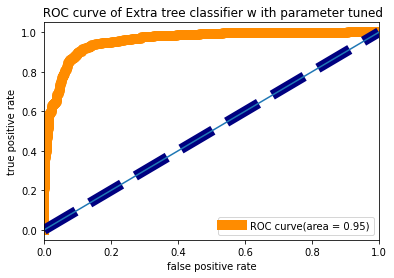

In [452]:
plt.figure()
plt.plot(fpr,tpr,color ="darkorange",lw = 10, label = "ROC curve(area = %0.2f)"%roc_auc)
plt.plot([0,1],[0,1]  , color = "navy" , lw = 10 ,  linestyle = "--" )
plt.xlim ([0.0 ,1.0] )
plt.plot([0.0 , 1.0])
plt.xlabel("false positive rate" )
plt.ylabel("true positive rate" )
plt.title (" ROC curve of Extra tree classifier w ith parameter tuned")
plt.legend(loc="lower right")


plt.show()

# saving 

In [454]:
import pickle
filename = "customer churn.pkl"
pickle.dump(ada, open(filename,"wb"))